# Bishop’s University
## Department of Computer Science
### CS462-CS562 – Image Processing & Mathematical Modeling of Image
### Winter 2024 – HW2


### Notes: 
1. Please provide your answer within the designated cells in the notebook. Do not create new cells.
2. Ensure that you create the functions as specified. Failure to adhere to the requirements may result in a score of zero. Also, make sure to maintain the numbering of the questions as listed in the homework document.

In [65]:
# 1. load_image()
import cv2 as cv
import matplotlib.pyplot as plt
import numpy as np
def load_image(filename):
    img = cv.imread(filename)
    imgGray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    imgGray = imgGray.astype(float)
    imgGray = imgGray/255.0

    return imgGray
img = load_image("lena.png")

In [66]:
# 2. add Gnnoise() # to add Gaussian noise
def add_Gnoise(img, std, mean=0):
    noise = np.random.normal(0, std, img.shape)
    noisyImg = img + noise
    noisyImg = np.clip(noisyImg, 0, 1)

    return noisyImg

In [67]:
# 3. add_SPnoise() # to add SP noise
def add_SPnoise(img, percentage):
    noiseSize = int(percentage*img.size)
    indices = np.random.choice(img.size, noiseSize)
    noisyImg = img.copy()
    noise = np.random.choice([img.min(), img.max()], noiseSize)
    noisyImg.flat[indices] = noise

    return noisyImg

In [68]:
# 4. filter_image()
def filter_image(img, filter):
    img = img.astype("float32")
    if filter == "Gaussian":
        filteredImg = cv.GaussianBlur(img, (5,5), 0)
    elif filter == "Median":
        filteredImg = cv.medianBlur(img, 5)
    elif filter == "Bilateral":
        filteredImg = cv.bilateralFilter(img, 5, 75, 75)

    return filteredImg


In [69]:
# 5. psnr()
def psnr(original, filtered):
    diff = original - filtered
    squaredDiff = np.square(diff)
    mse = np.mean(squaredDiff)

    psnr = (20*np.log10(1.0))-(10*np.log10(mse))

    return psnr

In [70]:
# 6. laod_image()
lena = load_image('lena.png')
mandrill = load_image("mandrill.png")
boat = load_image('boat.jpg')

In [71]:
# 7. add_Gnoise()  # add a noise
images = [lena, mandrill, boat]
levels = [0.05, 0.1, 0.15, 0.2]

gaussian = []

for image in images:
    for level in levels:
        gaussian.append(add_Gnoise(image, level))

<Figure size 640x480 with 0 Axes>

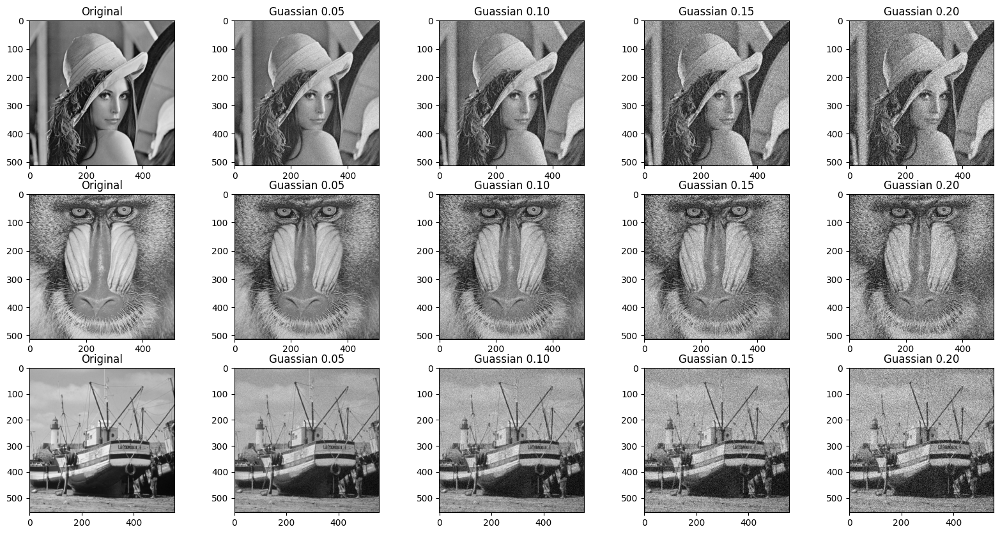

In [88]:
# 8. Display the original images and their corresponding noisy images. 

def displayNoise(noise, name):
    rows = len(images)
    cols = len(levels)

    plt.figure()
    fig, axarr = plt.subplots(rows, cols+1)
    fig.set_size_inches(20, 10)

    axarr[0, 0].set_title("Original")
    axarr[0, 0].imshow(lena, cmap='gray')
    axarr[1, 0].set_title("Original")
    axarr[1, 0].imshow(mandrill, cmap='gray')
    axarr[2, 0].set_title("Original")
    axarr[2, 0].imshow(boat, cmap='gray')

    for i in range(0, rows*cols):
        r = int(i / cols)
        c = (i % cols) +1
        level = ((i%cols) +1) * 0.05
        axarr[r][c].set_title("%s %.2f" %(name, level))
        axarr[r][c].imshow(noise[i], cmap='gray')

displayNoise(gaussian, "Guassian")

In [73]:
# 9. filter_image() # to filter an image. Use the three filters.
gausFilter = []
gausPSNR = []
medianFilter = []
medianPSNR = []
bilateralFilter = []
bilatPSNR = []

for img in gaussian:
    image = img.astype(float)
    gausFilter.append(filter_image(image, filter="Gaussian"))
    gausPSNR.append(psnr(image, gausFilter[-1]))
    medianFilter.append(filter_image(image, filter='Median'))
    medianPSNR.append(psnr(image, medianFilter[-1]))
    bilateralFilter.append(filter_image(image, filter='Bilateral'))
    bilatPSNR.append(psnr(image, bilateralFilter[-1]))


<Figure size 640x480 with 0 Axes>

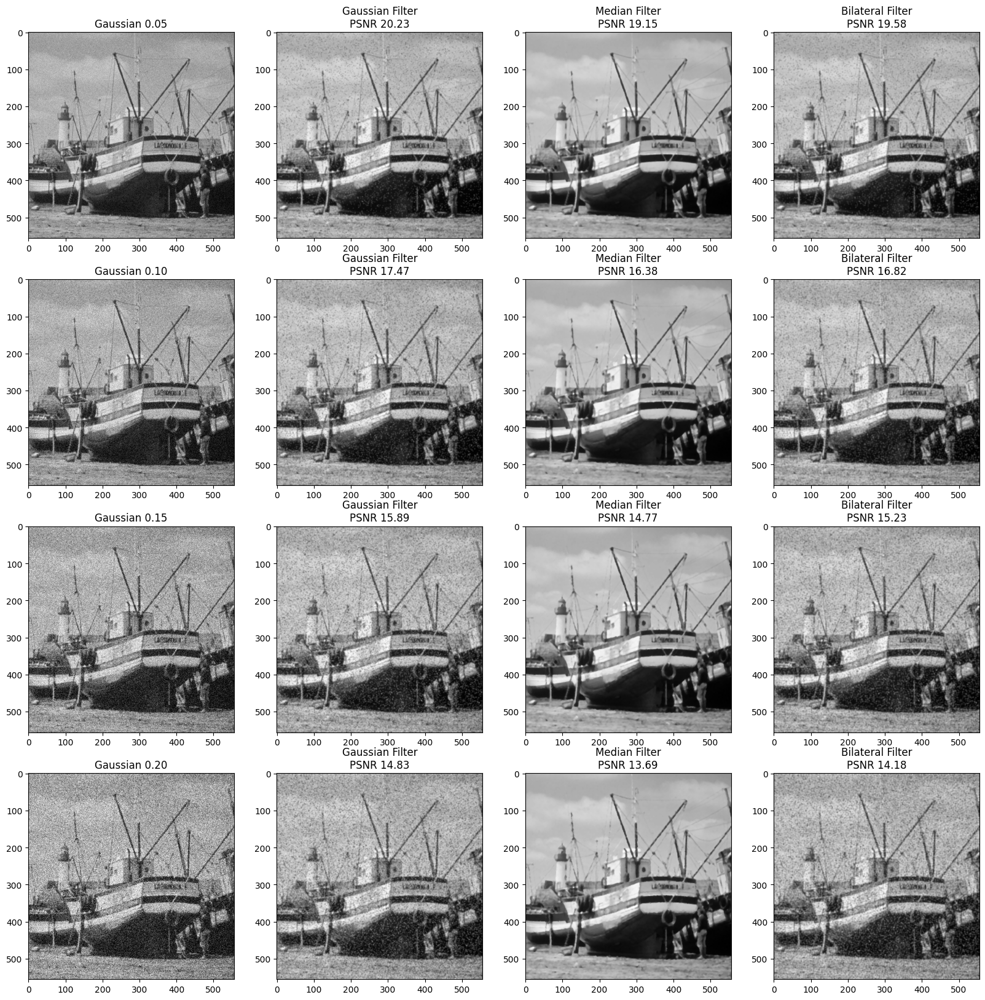

In [99]:
# 10.  Display the Boat noisy image with different levels of noise, and the filtered images

def display(start, end, noise, name):
    gaus = gausFilter[start:end]
    med = medianFilter[start:end]
    bilat = bilateralFilter[start:end]

    gPSNR = gausPSNR[start:end]
    mPSNR = medianPSNR[start:end]
    bPSNR = bilatPSNR[start:end]

    Original = noise[start:end]

    rows = len(Original)
    cols = 4
    plt.figure()
    fig, axarr = plt.subplots(rows, cols)
    fig.set_size_inches(20, 20)

    for c in range(0, cols):
        for r in range(0, rows):
            level = (r + 1) * 0.05
            if c == 0:
                axarr[r][c].set_title("%s %.2f" %(name, level))
                axarr[r][c].imshow(Original[r], cmap='gray')
            if c == 1:
                axarr[r][c].set_title("Gaussian Filter\nPSNR %.2f" %(gPSNR[r]))
                axarr[r][c].imshow(gaus[r], cmap='gray')
            if c == 2:
                axarr[r][c].set_title("Median Filter\nPSNR %.2f"%(mPSNR[r]))
                axarr[r][c].imshow(med[r], cmap='gray')
            if c == 3:
                axarr[r][c].set_title("Bilateral Filter\nPSNR %.2f"%(bPSNR[r]))
                axarr[r][c].imshow(bilat[r], cmap='gray')

start = int(len(gausFilter) - (len(gausFilter)/3))
end = len(gausFilter)
display(start, end, gaussian, "Gaussian")

<Figure size 640x480 with 0 Axes>

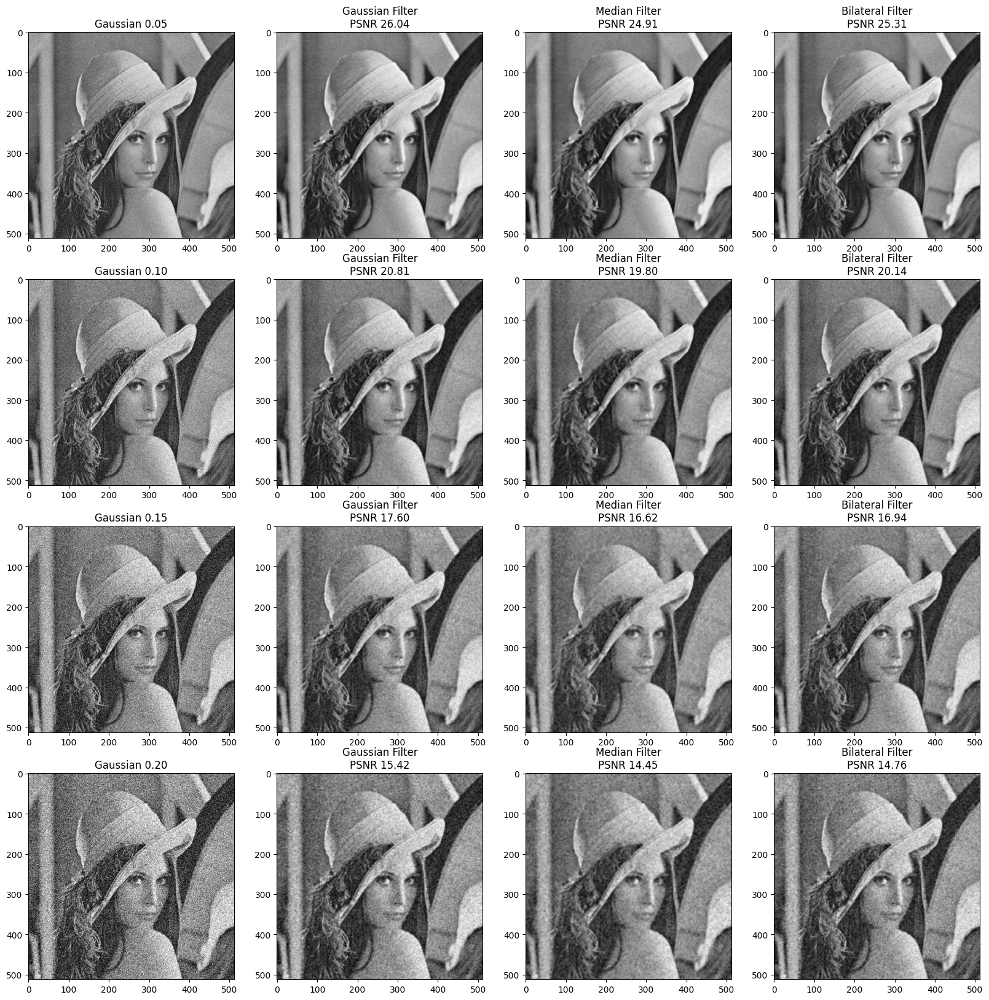

In [75]:
# 11.  a) Display Lena noisy image with different levels of noise, and the filtered images

start = 0
end = int(len(gausFilter)/3)
display(start,end, gaussian, "Gaussian")

<Figure size 640x480 with 0 Axes>

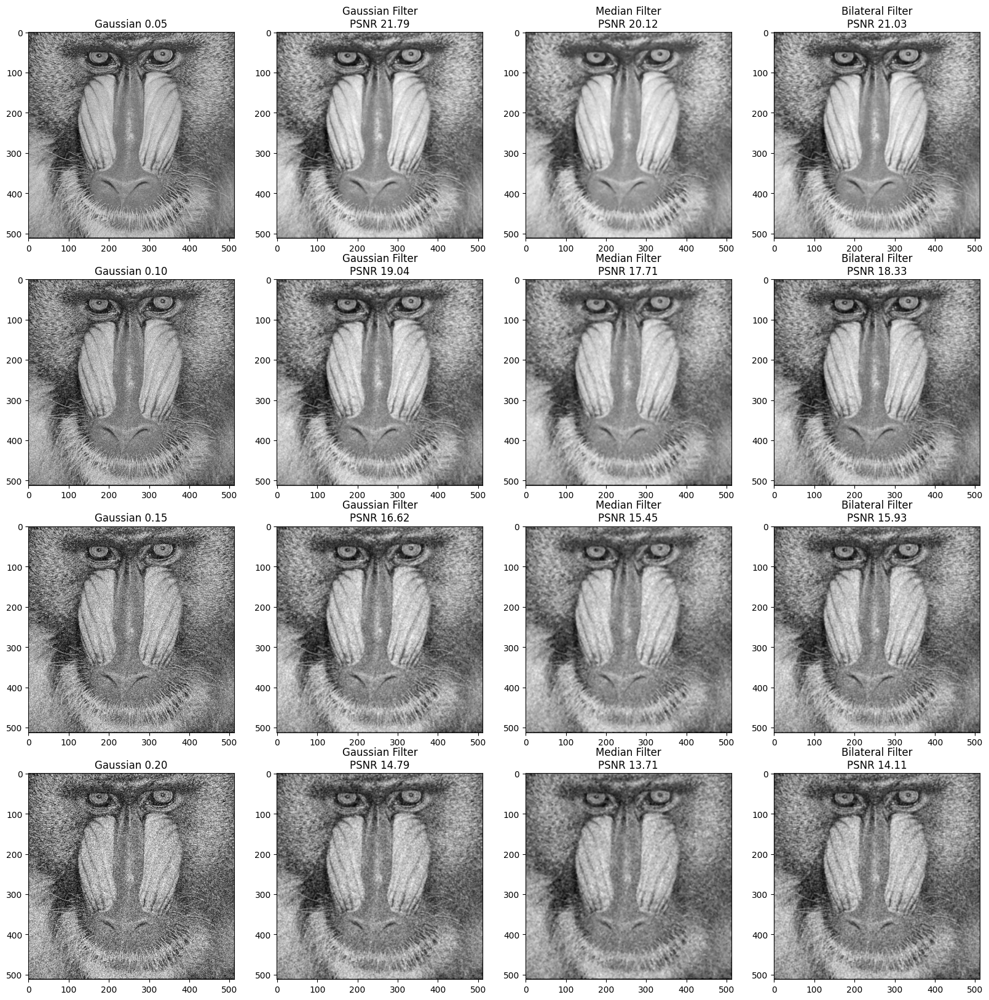

In [76]:
# 11.  b) Display Madrill noisy image with different levels of noise, and the filtered images

start = len(gausFilter) - int(2*len(gausFilter)/3)
end = len(gausFilter) - int(len(gausFilter)/3)
display(start, end, gaussian, "Gaussian")

In [90]:
# 12. add_SPnoise() # to add SP noise
saltPepper = []

for image in images:
    for level in levels:
        saltPepper.append(add_SPnoise(image, level))


<Figure size 640x480 with 0 Axes>

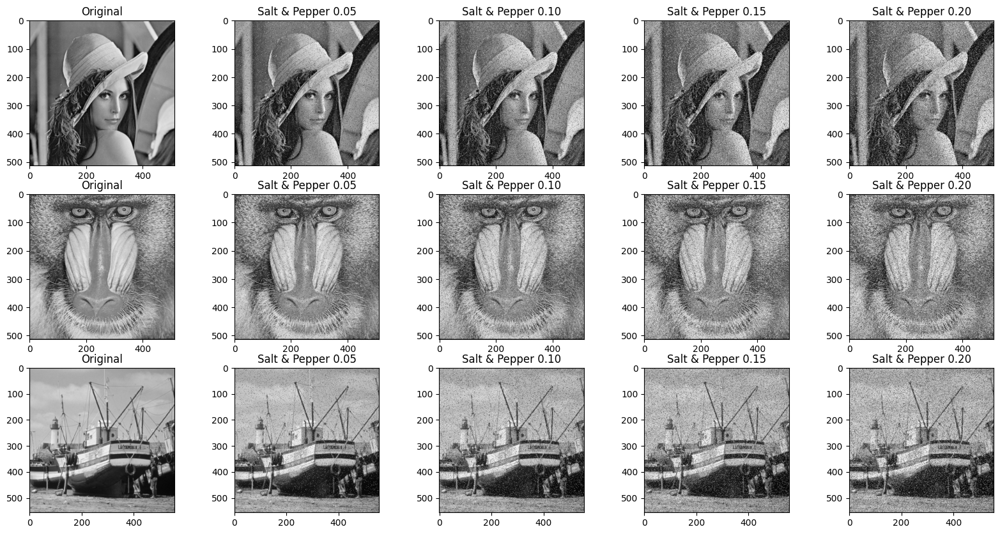

In [91]:
# 13. a) Display the original images and their corresponding noisy images. 
displayNoise(saltPepper, "Salt & Pepper")

In [93]:
# 13. b)  filter_image() # to filter an image. Use the three filters.
gausFilter = []
gausPSNR = []
medianFilter = []
medianPSNR = []
bilateralFilter = []
bilatPSNR = []

for img in saltPepper:
    image = img.astype(float)
    gausFilter.append(filter_image(image, filter="Gaussian"))
    gausPSNR.append(psnr(image, gausFilter[-1]))
    medianFilter.append(filter_image(image, filter='Median'))
    medianPSNR.append(psnr(image, medianFilter[-1]))
    bilateralFilter.append(filter_image(image, filter='Bilateral'))
    bilatPSNR.append(psnr(image, bilateralFilter[-1]))


<Figure size 640x480 with 0 Axes>

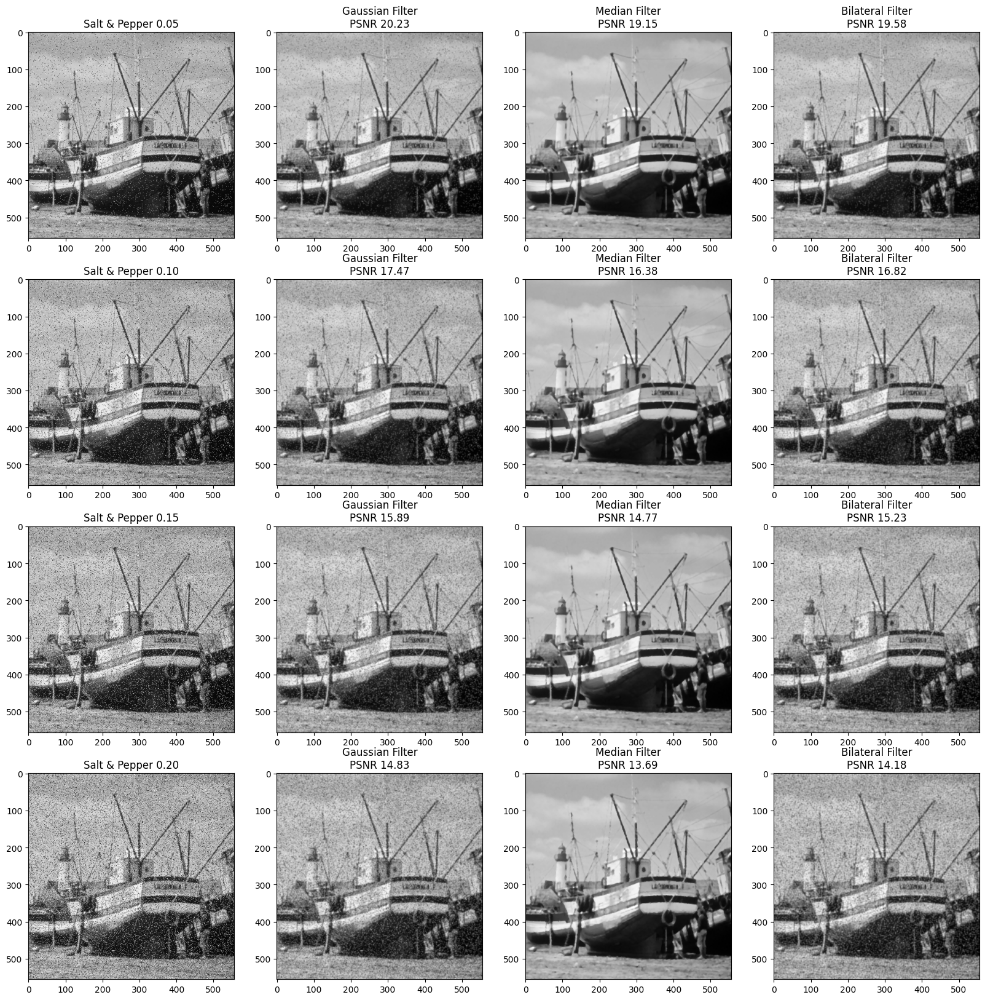

In [100]:
# 13. c) Display the Boat noisy image with different levels of noise, and the filtered images
start = int(len(gausFilter) - (len(gausFilter)/3))
end = len(gausFilter)
display(start, end, saltPepper, "Salt & Pepper")

<Figure size 640x480 with 0 Axes>

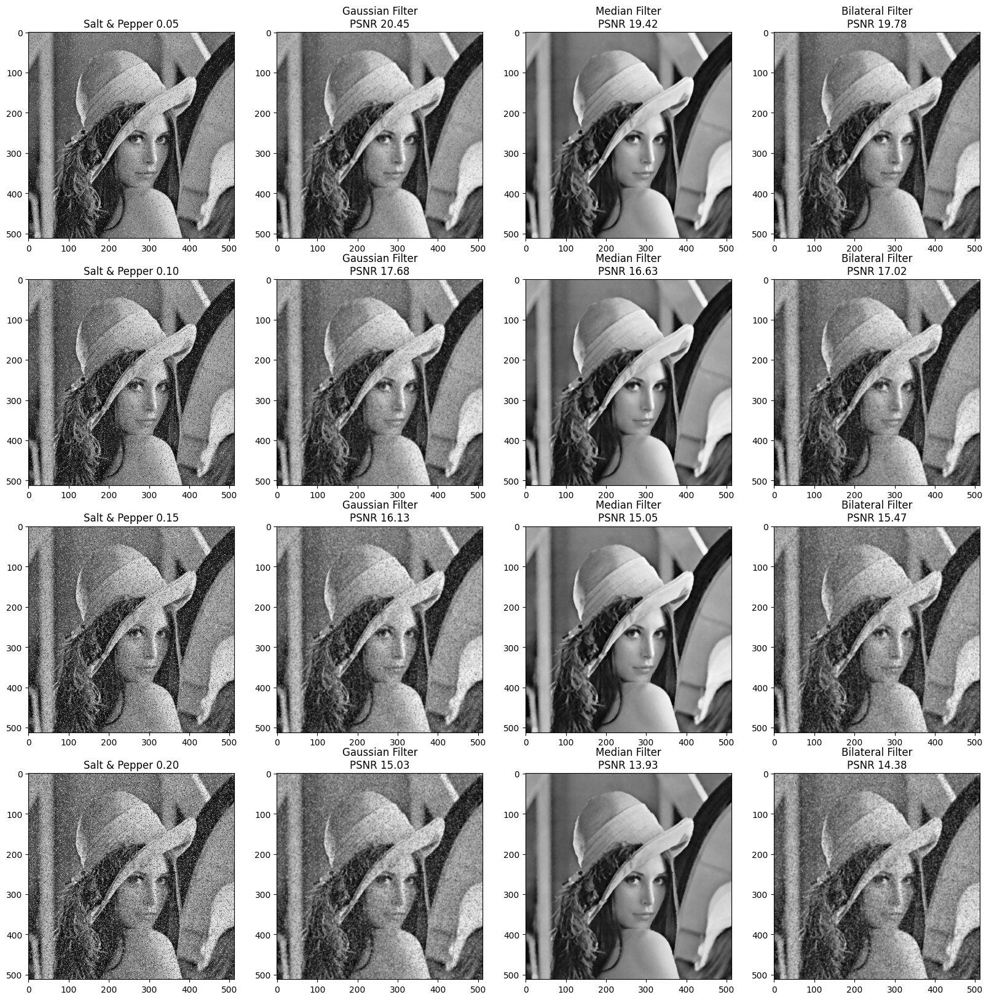

In [102]:
# 13. d) Display Lena noisy image with different levels of noise, and the filtered images
start = 0
end = int(len(gausFilter)/3)
display(start,end, saltPepper, "Salt & Pepper")

<Figure size 640x480 with 0 Axes>

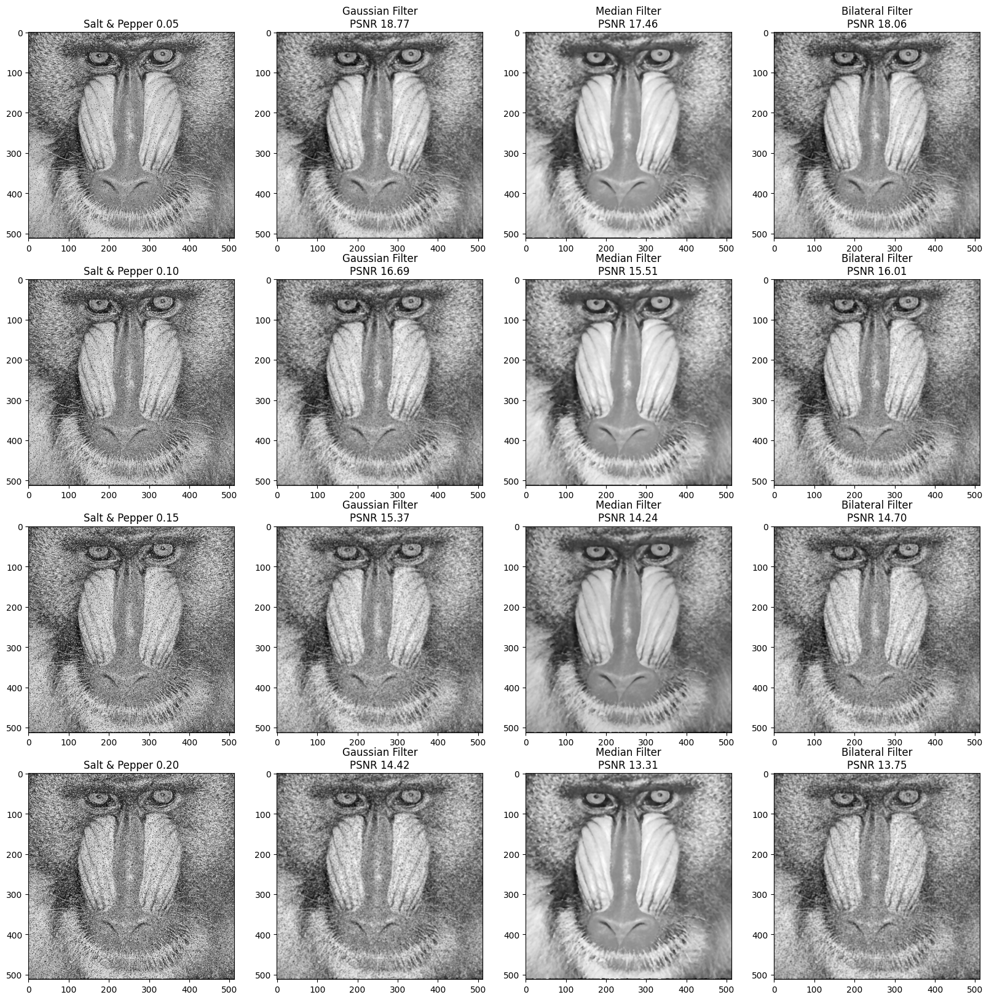

In [103]:
# 13. e) Display Madrill noisy image with different levels of noise, and the filtered images
start = len(gausFilter) - int(2*len(gausFilter)/3)
end = len(gausFilter) - int(len(gausFilter)/3)
display(start, end, saltPepper, "Salt & Pepper")

In [104]:
# 14. smooth_image() # to smooth Mandrill image
def smooth_image(img, kernelSize):
    filtered = cv.GaussianBlur(img, (kernelSize, kernelSize), 0)
    return filtered

In [199]:
# 15. Laplace_sharpening() # to sharpen the image
def laplace_sharpening(img, kernelSize):
    ddepth = -1
    sharpened = cv.Laplacian(img, ddepth, ksize=kernelSize)
    sharpened = cv.convertScaleAbs(sharpened)

    sharpened = (sharpened.astype(float)/sharpened.max())
    enhanced = img + sharpened
    
    return enhanced

<Figure size 640x480 with 0 Axes>

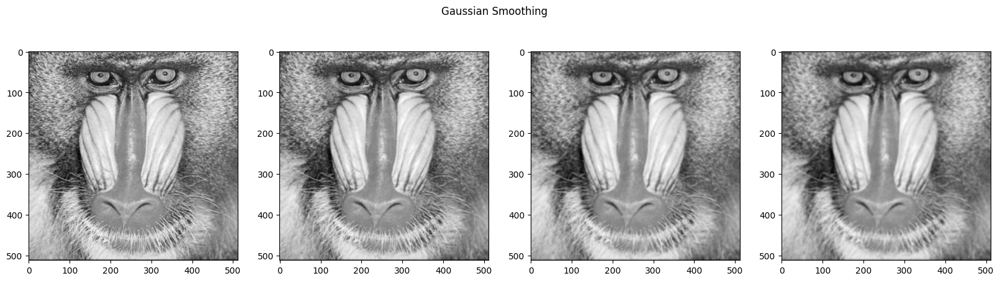

<Figure size 640x480 with 0 Axes>

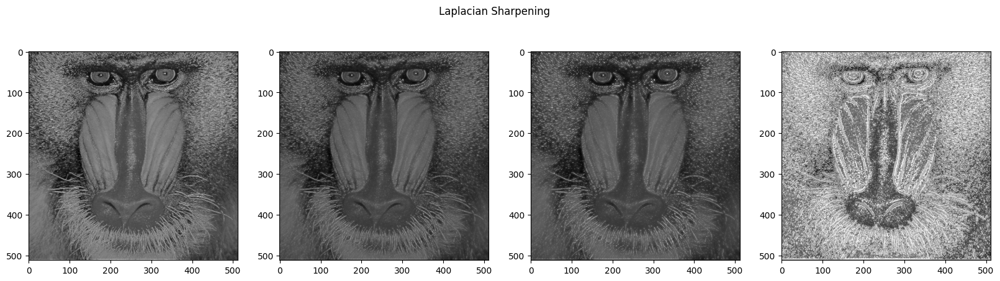

In [200]:
# 16. Present various smoothed and sharpened images, showcasing different parameter values.

plt.figure()
fig, axarr = plt.subplots(1, 4)
fig.set_size_inches(20, 5)
fig.suptitle("Gaussian Smoothing")

size = 3
for i in range(0, 4):
    kSize = (i*2) + size
    axarr[i].imshow(smooth_image(mandrill, kSize), cmap='gray')

plt.figure()
fig, axarr = plt.subplots(1, 4)
fig.set_size_inches(20, 5)
fig.suptitle("Laplacian Sharpening")

size = 3
for i in range(0, 4):
    kSize = (i*2) + size
    axarr[i].imshow(laplace_sharpening(mandrill, kSize), cmap='gray')
